<a href="https://colab.research.google.com/github/yingzibu/MOL2ADMET/blob/main/examples/experiments/VAE/VAE_only_on_data_M5_11_08.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
! pip install PyTDC --quiet
! pip install selfies  --quiet
! pip install pubchempy --quiet
! pip install rdkit --quiet
! pip install mycolorpy --quiet
! pip install dgllife --quiet
! pip install molvs --quiet
! pip install dgl -f https://data.dgl.ai/wheels/cu118/repo.html --quiet
! pip install dglgo -f https://data.dgl.ai/wheels-test/repo.html --quiet

! pip install DeepPurpose --quiet
! pip install git+https://github.com/bp-kelley/descriptastorus --quiet
! pip install pandas-flavor --quiet

## Code

In [ ]:
cd /content/drive/MyDrive/ADMET

/content/drive/MyDrive/ADMET


In [ ]:
from scripts.func_utils import *
from scripts.yaml_utils import *
from scripts.eval_utils import *
from scripts.preprocess_mols import *
from scripts.model_architecture import *
from scripts.dataset import *
from scripts.train import *
from tdc.utils import retrieve_label_name_list
import pandas as pd
from scripts.get_vocab import *

from tdc.single_pred import ADME
from tdc.single_pred import Tox
label_list = retrieve_label_name_list('herg_central')


## Train M5

In [ ]:
names = names_M5

vocab_type = 'smiles'
trn, val, tst = collect_data(names)
config = get_config('VAE', names, scale_dict=None, vocab_type=vocab_type)
path_here = f'M5/VAE_{vocab_type}'
config['model_path'] = f'{path_here}.pt'
config['encoder_path'] = f'{path_here}_encoder.pt'
config['decoder_path'] = f'{path_here}_decoder.pt'
config['classifier_path'] = f'{path_here}_classifier.pt'
config['config_path'] = f'{path_here}.yml'
config['figure_path'] = f'{path_here}/fig'
config['MAX_EPOCH'] = 100
config['patience'] = 10
config['verbose_freq'] = 10
config['uw'] = True
trn_l, val_l, tst_l, vocab = get_multi_loader(trn, val, tst, config)

# models.load_model('VAE/qed_sa.pt') # load model from pretrained on qed and sa


In [ ]:
models = PRED(**config)

Model type:  VAE | Model parameters:  7889067


In [ ]:
p = models.train(trn_l, val_l, tst_l, tst, len(tst), 1)

In [ ]:
performance = yml_report(config['config_path'], recalculate=True)

In [ ]:
a = eval_perf_list([performance], names, {})

******************** CYP2C19_Veith ******************** 
	|  acc  |  w_acc  |  prec  |  recall  |  sp  |  f1  |  auc  |  mcc  |  ap  
single: &0.814   &0.816   &0.777   &0.835   &0.796   &0.805   &0.887   &0.629   &0.853   
******************** CYP2D6_Veith ******************** 
	|  acc  |  w_acc  |  prec  |  recall  |  sp  |  f1  |  auc  |  mcc  |  ap  
single: &0.852   &0.694   &0.651   &0.443   &0.946   &0.527   &0.829   &0.455   &0.609   
******************** CYP3A4_Veith ******************** 
	|  acc  |  w_acc  |  prec  |  recall  |  sp  |  f1  |  auc  |  mcc  |  ap  
single: &0.763   &0.761   &0.698   &0.749   &0.772   &0.723   &0.847   &0.517   &0.786   
******************** CYP1A2_Veith ******************** 
	|  acc  |  w_acc  |  prec  |  recall  |  sp  |  f1  |  auc  |  mcc  |  ap  
single: &0.839   &0.841   &0.800   &0.877   &0.804   &0.837   &0.916   &0.681   &0.905   
******************** CYP2C9_Veith ******************** 
	|  acc  |  w_acc  |  prec  |  recall  |  sp  |  f1

In [ ]:
import imageio

path = config['figure_path']
from os import walk
# files = next(walk(path), (None, None, []))[2]
# files
# for path in ['QED', 'SA']:
# name = ['qed', 'sa']
name = names_M5

def create_gif(fig_path:str, name:list):
    import imageio
    for n in name:
        images = []
        for i in range(0,100):
            for j in range(1):
                file_name = fig_path + f'/PCA_{n}_{i}.png'
                try:
                    images.append(imageio.imread(file_name))
                except: pass
        gif_path = f'{fig_path}_{n}.gif'
        imageio.mimsave(gif_path, images, duration=1)
        from IPython.display import Image
        print('---> load gif from ', gif_path)
        display(Image(data=open(gif_path,'rb').read(), format='png'))

In [ ]:
encoder_path = 'VAE/qed_sa_encoder.pt'
decoder_path = 'VAE/qed_sa_decoder.pt'

In [ ]:
names = names_M5

vocab_type = 'smiles'
trn, val, tst = collect_data(names)
config = get_config('VAE', names, scale_dict=None, vocab_type=vocab_type)
path_here = f'M5/VAE_{vocab_type}_pretrain'
config['model_path'] = f'{path_here}.pt'
config['encoder_path'] = f'{path_here}_encoder.pt'
config['decoder_path'] = f'{path_here}_decoder.pt'
config['classifier_path'] = f'{path_here}_classifier.pt'
config['config_path'] = f'{path_here}.yml'
config['figure_path'] = f'{path_here}/fig'
config['MAX_EPOCH'] = 100
config['patience'] = 10
config['verbose_freq'] = 10
config['uw'] = True
trn_l, val_l, tst_l, vocab = get_multi_loader(trn, val, tst, config)
# print(config['config_path'])

In [ ]:
models = PRED(**config)
models.load_encoder(encoder_path)
models.load_decoder(decoder_path)

Model type:  VAE | Model parameters:  7889067
Finish load encoder from VAE/qed_sa_encoder.pt
Finish load decoder from VAE/qed_sa_decoder.pt


In [ ]:
p = models.train(trn_l, val_l, tst_l, tst, len(tst), 1)

In [ ]:
models.load_vae_pretrain()
p_recal = yml_report(config['config_path'], recalculate=True)

In [ ]:
## without pretrain
m5_no_pretrain_config = 'M5/VAE_smiles.yml'
p = yml_report(m5_no_pretrain_config, recalculate=True)

m5_pretrain_config = 'M5/VAE_smiles_pretrain.yml'
p_train = yml_report(m5_pretrain_config, recalculate=True)

no use psudo label, w/o pretrain on ZINC with QED/SA

---------------------------------------- no pretrain on ZINC ----------------------------------------
******************** CYP2C19_Veith ******************** 
	|  acc  |  w_acc  |  prec  |  recall  |  sp  |  f1  |  auc  |  mcc  |  ap  
single: &0.804   &0.804   &0.778   &0.801   &0.806   &0.789   &0.877   &0.606   &0.837   
******************** CYP2D6_Veith ******************** 
	|  acc  |  w_acc  |  prec  |  recall  |  sp  |  f1  |  auc  |  mcc  |  ap  
single: &0.861   &0.692   &0.713   &0.422   &0.961   &0.530   &0.829   &0.476   &0.613   
******************** CYP3A4_Veith ******************** 
	|  acc  |  w_acc  |  prec  |  recall  |  sp  |  f1  |  auc  |  mcc  |  ap  
single: &0.760   &0.745   &0.731   &0.662   &0.829   &0.695   &0.848   &0.499   &0.787   
******************** CYP1A2_Veith ******************** 
	|  acc  |  w_acc  |  prec  |  recall  |  sp  |  f1  |  auc  |  mcc  |  ap  
single: &0.834   &0.836   &0.799   &0.867

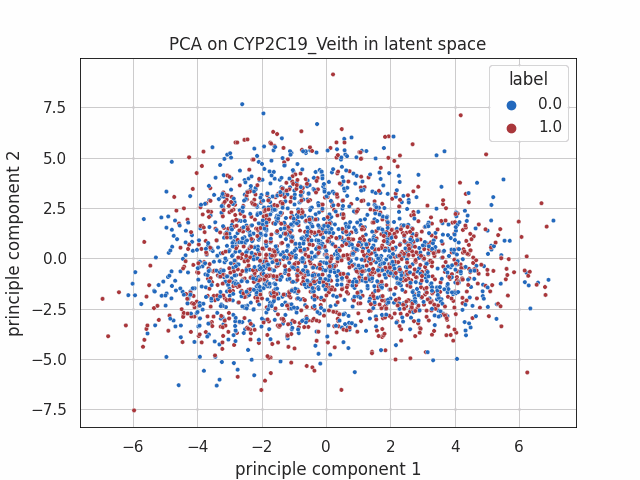

---> load gif from  M5/VAE_smiles/fig_CYP2D6_Veith.gif


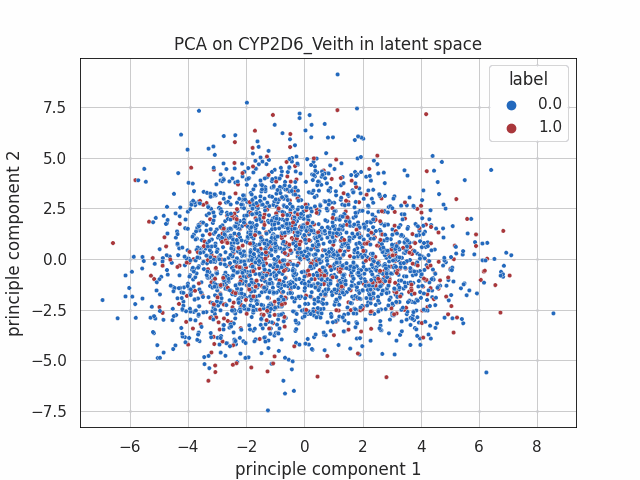

---> load gif from  M5/VAE_smiles/fig_CYP3A4_Veith.gif


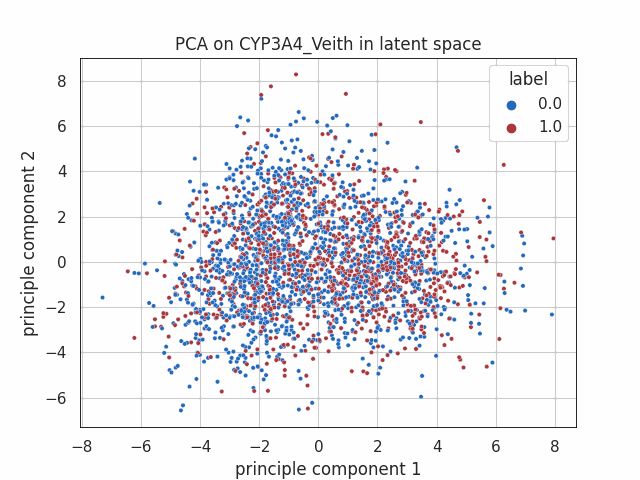

---> load gif from  M5/VAE_smiles/fig_CYP1A2_Veith.gif


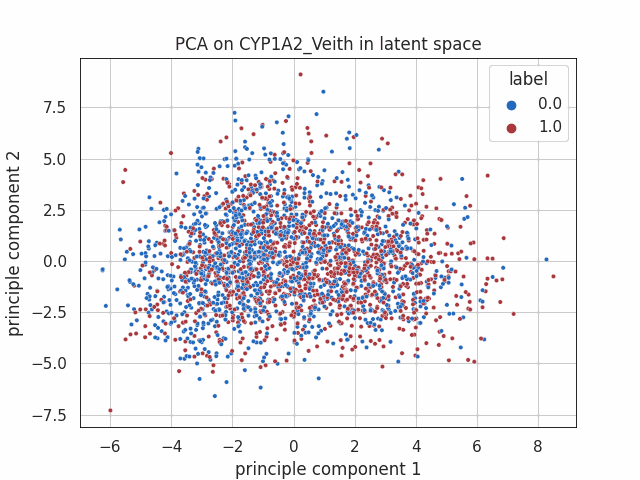

---> load gif from  M5/VAE_smiles/fig_CYP2C9_Veith.gif


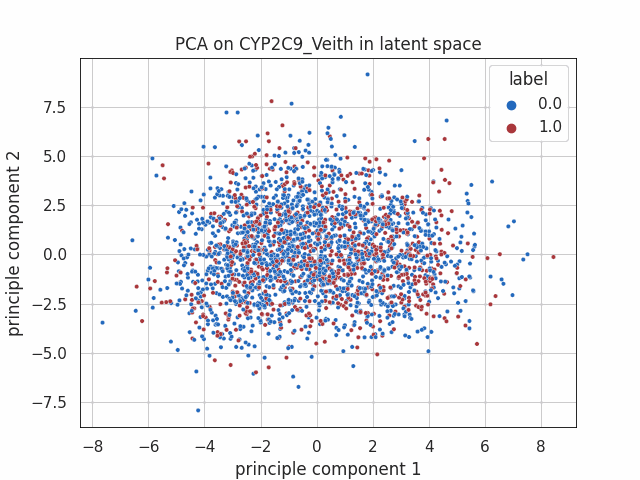

---------------------------------------- with pretrain on ZINC ----------------------------------------
******************** CYP2C19_Veith ******************** 
	|  acc  |  w_acc  |  prec  |  recall  |  sp  |  f1  |  auc  |  mcc  |  ap  
single: &0.816   &0.816   &0.785   &0.824   &0.809   &0.804   &0.888   &0.631   &0.852   
******************** CYP2D6_Veith ******************** 
	|  acc  |  w_acc  |  prec  |  recall  |  sp  |  f1  |  auc  |  mcc  |  ap  
single: &0.859   &0.666   &0.754   &0.359   &0.973   &0.486   &0.818   &0.455   &0.596   
******************** CYP3A4_Veith ******************** 
	|  acc  |  w_acc  |  prec  |  recall  |  sp  |  f1  |  auc  |  mcc  |  ap  
single: &0.787   &0.783   &0.731   &0.764   &0.803   &0.747   &0.866   &0.563   &0.815   
******************** CYP1A2_Veith ******************** 
	|  acc  |  w_acc  |  prec  |  recall  |  sp  |  f1  |  auc  |  mcc  |  ap  
single: &0.847   &0.848   &0.825   &0.859   &0.837   &0.842   &0.925   &0.695   &0.915   
***

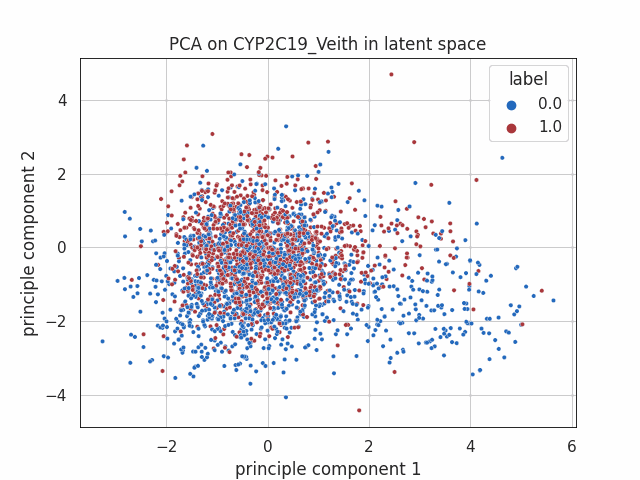

---> load gif from  M5/VAE_smiles_pretrain/fig_CYP2D6_Veith.gif


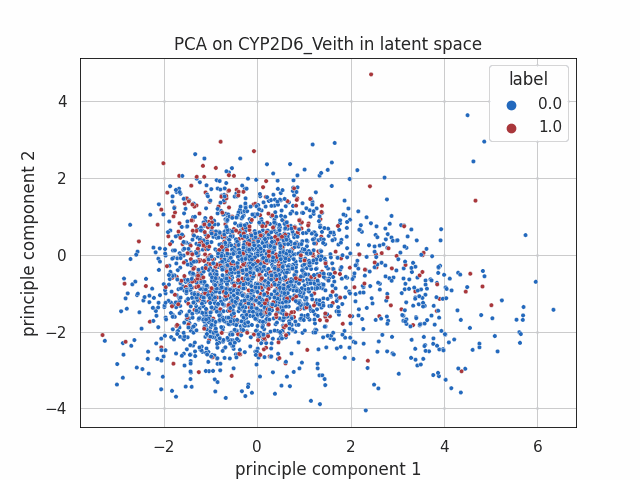

---> load gif from  M5/VAE_smiles_pretrain/fig_CYP3A4_Veith.gif


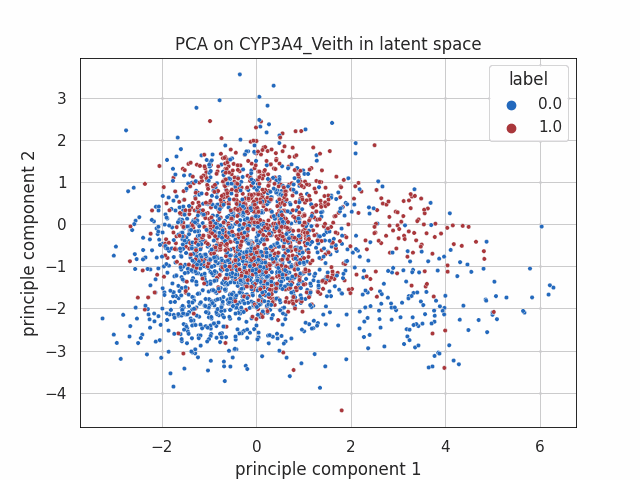

---> load gif from  M5/VAE_smiles_pretrain/fig_CYP1A2_Veith.gif


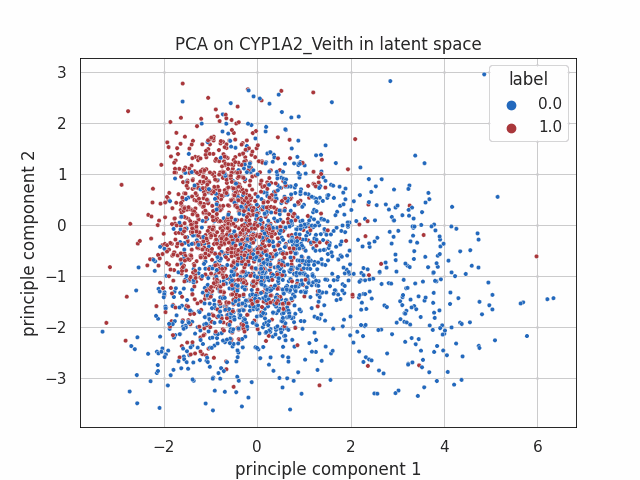

---> load gif from  M5/VAE_smiles_pretrain/fig_CYP2C9_Veith.gif


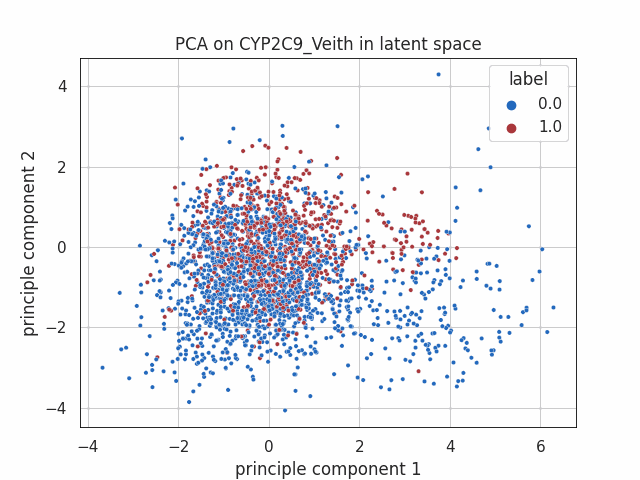

In [ ]:
# with pretrain
print('no use psudo label, w/o pretrain on ZINC with QED/SA\n')
print('-'*40, 'no pretrain on ZINC', '-'*40)
eval_perf_list([p], names, {})
create_gif('M5/VAE_smiles/fig', names)

print('-'*40, 'with pretrain on ZINC', '-'*40)
eval_perf_list([p_train], names, {})
create_gif('M5/VAE_smiles_pretrain/fig', names)